In [1]:
from sklearn.metrics import classification_report, confusion_matrix
from skimage.metrics import structural_similarity as ssim
from sklearn import preprocessing
from keras.utils import to_categorical
from keras import regularizers
from keras.models import Model
from keras.callbacks import ModelCheckpoint
from keras.layers import Input, Dense, Dropout, Lambda, GlobalAveragePooling2D
from keras.src.legacy.preprocessing.image import ImageDataGenerator

import random
import re
import glob
from tqdm import tqdm
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import time
import gc

2025-03-07 18:01:20.333598: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-07 18:01:20.342877: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-07 18:01:20.346771: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-07 18:01:20.356396: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"GPUs disponíveis: {gpus}")
else:
    print("Nenhuma GPU encontrada.")

GPUs disponíveis: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


I0000 00:00:1741381282.284730    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741381282.319139    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741381282.319248    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.


In [3]:
# nome = 'PACS'
nome = 'Yildirim'
#nome = 'Todos'

imgs_path = 'Bases/Dataset' + nome

TEST_SIZE = 0.1
VALIDATION_SIZE = 0.1

SIMILARITY = 0.75

EPOCHS = 100
BATCH_SIZE = 32

HIGH_FREQ_THRESHOLD = 88

In [4]:
def get_next_filename(output_folder, base_name, type):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    image_index = 0
    
    while True:
        output_filename = f"{base_name}_{image_index}.{type}"
        output_path = os.path.join(output_folder, output_filename)
        
        if not os.path.exists(output_path):
            return output_filename
            
        image_index += 1

In [5]:
def extract_number(filename):
    match = re.search(r'(\d+)', filename)
    return int(match.group(0)) if match else 0

In [6]:
def sort_files_numerically(file_paths):
    return sorted(file_paths, key=lambda x: extract_number(x))

In [7]:
def find_groups(images, image_paths, test_size, similarity_threshold):
    def are_similar(img1, img2, threshold):
        similarity = ssim(img1, img2)
        return similarity >= threshold

    groups = []
    current_group = [image_paths[0]]

    for i in range(1, len(images)):
        if are_similar(images[i-1], images[i], similarity_threshold):
            current_group.append(image_paths[i])
        else:
            groups.append(current_group)
            current_group = [image_paths[i]]
    
    if current_group:
        groups.append(current_group)

    all_images = [img_path for group in groups for img_path in group]

    for img_path in image_paths:
        if img_path not in all_images:
            groups.append([img_path])

    random.shuffle(groups)

    train_set = []
    test_set = []
    current_test_size = 0
    
    for i, group in enumerate(groups):
        if current_test_size + len(group) <= test_size:
            test_set.extend(group)
            current_test_size += len(group)
        else:
            train_set.extend(group)

    return train_set, test_set

In [8]:
output_folder = 'Groups'
type = 'txt'

def save_groups(train_groups, test_groups, base_name):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    with open(output_path, 'w') as file:
        file.write('- test:\n')
        for idx, group in enumerate(test_groups, start=1):
            for img in group:
                file.write(f"{img}\n")
        
        file.write('- train:\n')
        for idx, group in enumerate(train_groups, start=1):
            for img in group:
                file.write(f'{img}\n')
    
    print(f'Group information saved in {output_path}')

In [9]:
def read_dataset(path, jpg, png):
    print(f'Reading dataset...\n')
    
    img_type = []
    images = []
    image_paths = []

    if jpg:
        img_type.append('*.jpg')
    if png:
        img_type.append('*.png')

# Normal
    
    normal_path = os.path.join(path, 'Train', 'Normal')
    normal_images = []
    normal_image_paths = []
    print(f'Reading Normal images from: {normal_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(normal_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            normal_images.append(img)
            normal_image_paths.append(img_path)

    normal_images = np.array(normal_images)
    normal_image_paths = np.array(normal_image_paths)

# Normal Groups

    normal_total_images = len(normal_images)
    normal_test_size = int(normal_total_images * TEST_SIZE)

    print(f'Total number of normal images: {normal_total_images}')
    print(f'Calculated normal test size: {normal_test_size}')

    normal_train_set, normal_test_set = find_groups(normal_images, normal_image_paths, normal_test_size, SIMILARITY)

    print(f'Number of normal images in train set: {len(normal_train_set)}')
    print(f'Number of normal images in test set: {len(normal_test_set)}\n')

# Kidney
    
    kidney_stone_path = os.path.join(path, 'Train', 'Kidney_stone')
    kidney_stone_images = []
    kidney_stone_image_paths = []
    print(f'Reading Kidney_stone images from: {kidney_stone_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(kidney_stone_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            kidney_stone_images.append(img)
            kidney_stone_image_paths.append(img_path)

    kidney_stone_images = np.array(kidney_stone_images)
    kidney_stone_image_paths = np.array(kidney_stone_image_paths)

# Kidney Groups
    
    kidney_stone_total_images = len(kidney_stone_images)
    kidney_stone_test_size = int(kidney_stone_total_images * TEST_SIZE)

    print(f'Total number of kidney images: {kidney_stone_total_images}')
    print(f'Calculated kidney test size: {kidney_stone_test_size}')

    kidney_stone_train_set, kidney_stone_test_set = find_groups(kidney_stone_images, kidney_stone_image_paths, kidney_stone_test_size, SIMILARITY)
    
    train_groups = [normal_train_set, kidney_stone_train_set]
    test_groups = [normal_test_set, kidney_stone_test_set]
    
    output_folder = 'Groups'
    base_name = 'groups_' + nome
    save_groups(train_groups, test_groups, base_name)

    print(f'Number of kidney images in train set: {len(kidney_stone_train_set)}')
    print(f'Number of kidney images in test set: {len(kidney_stone_test_set)}')

# ...
    
    X_train = []
    X_test = []

    for img_path in normal_train_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_train.append(normal_images[idx])

    for img_path in normal_test_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_test.append(normal_images[idx])

    for img_path in kidney_stone_train_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_train.append(kidney_stone_images[idx])

    for img_path in kidney_stone_test_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_test.append(kidney_stone_images[idx])

    X_train = np.array(X_train)
    X_test = np.array(X_test)

    return X_train, X_test

In [10]:
X_train, X_test = read_dataset(path=imgs_path, jpg=True, png=True)

Reading dataset...

Reading Normal images from: Bases/DatasetYildirim/Train/Normal
Total number of normal images: 1009
Calculated normal test size: 100
Number of normal images in train set: 909
Number of normal images in test set: 100

Reading Kidney_stone images from: Bases/DatasetYildirim/Train/Kidney_stone
Total number of kidney images: 790
Calculated kidney test size: 79
Group information saved in Groups/groups_Yildirim_24.txt
Number of kidney images in train set: 711
Number of kidney images in test set: 79


In [11]:
X_train_orig = X_train.copy()
X_test_orig = X_test.copy()

In [12]:
'''
def freq_spec(image, threshold, add_noise):
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)

#   print(add_noise)

    if add_noise:
        noise_level = 500.0

        rows, cols = image.shape
        crow, ccol = rows//2, cols//2

        mask = np.zeros((rows, cols), dtype=bool)
        mask[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = True
        high_freq_mask = ~mask  # Inverte a máscara para aplicar nas altas frequências

        noise_real = np.random.normal(0, noise_level, fshift.shape)
        noise_imag = np.random.normal(0, noise_level, fshift.shape)

        fshift += (noise_real + 1j * noise_imag) * high_freq_mask

    magnitude_spectrum_high = 20 * np.log(np.abs(fshift) + 1)

    return magnitude_spectrum_high

'''
def freq_spec(image, threshold, add_noise):
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)

    if add_noise:
        amplification_factor = 0.5
        
        rows, cols = image.shape
        crow, ccol = rows//2, cols//2

        mask = np.zeros((rows, cols), dtype=bool)
        mask[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = True
        high_freq_mask = ~mask

        fshift[high_freq_mask] *= amplification_factor

    magnitude_spectrum_high = 20 * np.log(np.abs(fshift) + 1)

    return magnitude_spectrum_high
#'''

In [13]:
def save_specs(images, threshold, add_noise):
    specs = []
    for img in images:
        specs.append(freq_spec(img, threshold, add_noise))
    return specs

In [14]:
len_normal_train_specs = int(len(X_train_orig) / 2)
len_normal_test_specs = int(len(X_test_orig) / 2)

In [15]:
normal_train_specs = X_train_orig[0:len_normal_train_specs]
normal_test_specs = X_test_orig[0:len_normal_test_specs]

In [16]:
normal_train_specs = save_specs(normal_train_specs, HIGH_FREQ_THRESHOLD, add_noise = False)
normal_test_specs = save_specs(normal_test_specs, HIGH_FREQ_THRESHOLD, add_noise = False)

In [17]:
print(len(normal_train_specs))
print(len(normal_test_specs))

810
89


In [18]:
hacked_train_specs = X_train_orig[len_normal_train_specs:len(X_train_orig)]
hacked_test_specs = X_test_orig[len_normal_test_specs:len(X_test_orig)]

In [19]:
hacked_train_specs = save_specs(hacked_train_specs, HIGH_FREQ_THRESHOLD, add_noise = True)
hacked_test_specs = save_specs(hacked_test_specs, HIGH_FREQ_THRESHOLD, add_noise = True)

In [20]:
print(len(hacked_train_specs))
print(len(hacked_test_specs))

810
90


In [21]:
def plot_specs(specs, title):
    total_images = len(specs)
    imgs_per_figure = 100
    cols = 5
    rows = (imgs_per_figure + cols - 1) // cols

    for start in range(0, total_images, imgs_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + imgs_per_figure, total_images)
        
        for i in range(start, end):
            plt.subplot(rows, cols, i - start + 1)
            plt.imshow(specs[i], cmap='gray')
            plt.title(f"{title} - freq spec: img {i+1}")
            plt.axis('off')
            
        plt.tight_layout()
        plt.show()

In [22]:
# Plotar todos os espectros de treino
#plot_specs(normal_train_specs, title="train")

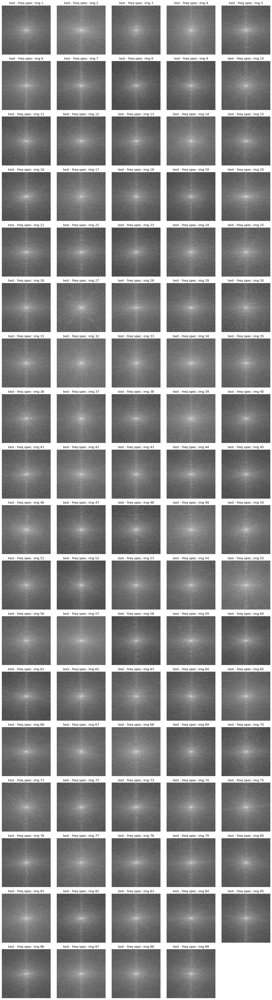

In [23]:
# Plotar todos os espectros de teste
plot_specs(normal_test_specs, title="test")

In [24]:
#pausa de teste

In [25]:
# Plotar todos os espectros de treino com ruído
#plot_specs(hacked_train_specs, title="train *")

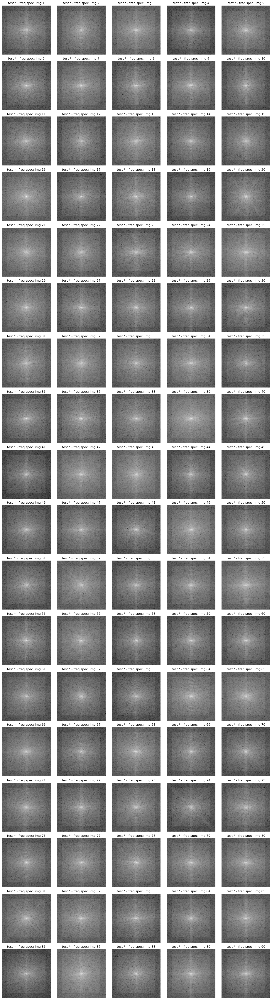

In [26]:
# Plotar todos os espectros de teste com ruído
plot_specs(hacked_test_specs, title="test *")

In [27]:
# Labels:
normal_train_labels = np.zeros(len(normal_train_specs), dtype=bool)
hacked_train_labels = np.ones(len(hacked_train_specs), dtype=bool)

normal_test_labels = np.zeros(len(normal_test_specs), dtype=bool)
hacked_test_labels = np.ones(len(hacked_test_specs), dtype=bool)

# Combina os espectros
all_train_specs = np.concatenate((normal_train_specs, hacked_train_specs), axis=0)
all_train_labels = np.concatenate((normal_train_labels, hacked_train_labels))

all_test_specs = np.concatenate((normal_test_specs, hacked_test_specs), axis=0)
all_test_labels = np.concatenate((normal_test_labels, hacked_test_labels))

print("Tamanho do conjunto de treino:", all_train_specs.shape)
print("Tamanho do conjunto de teste:", all_test_specs.shape)
print("Exemplo dos labels de treino (False = original, True = com ruído):", all_train_labels)

Tamanho do conjunto de treino: (1620, 224, 224)
Tamanho do conjunto de teste: (179, 224, 224)
Exemplo dos labels de treino (False = original, True = com ruído): [False False False ...  True  True  True]


In [28]:
#pausa de teste

In [29]:
# Pré-processamento dos dados: adiciona dimensão do canal
all_train_specs = np.expand_dims(all_train_specs, axis=-1)
all_test_specs = np.expand_dims(all_test_specs, axis=-1)

# Converte os labels para o formato one-hot
all_train_labels_cat = to_categorical(all_train_labels.astype(int), num_classes=2)
all_test_labels_cat = to_categorical(all_test_labels.astype(int), num_classes=2)

In [30]:
# Defines the model layers
def model_resnet152():
    # Camada de entrada para imagens em escala de cinza
    inputs = Input(shape=(224, 224, 1))
    
    # 1. Converter imagem para 3 canais (replicando o canal único)
    x = Lambda(lambda x: tf.repeat(x, 3, axis=-1))(inputs)
    
    # 2. Pré-processamento específico para ResNet
    x = tf.keras.applications.resnet.preprocess_input(x)
    
    # 3. Carregar ResNet-152 sem o topo (include_top=False)
    base_model = tf.keras.applications.ResNet152(
        weights='imagenet',  # Usar pesos pré-treinados
        include_top=False,   # Remover camadas fully-connected
        input_tensor=x
    )
    
    # 4. Adicionar novas camadas no topo
    x = base_model.output
    x = GlobalAveragePooling2D()(x)  # Melhor que Flatten para redes grandes
    
    # Camadas densas personalizadas (mantendo sua estrutura original)
    x = Dense(150, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)
    
    x = Dense(100, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)
    
    outputs = Dense(2, activation='softmax')(x)
    
    # Criar e compilar modelo
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(
        optimizer='Adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

In [31]:
# Create model
model = model_resnet152()

I0000 00:00:1741381347.657085    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741381347.657192    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741381347.657243    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741381348.153557    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741381348.153676    3290 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-03-07

In [32]:
# Print the model summary
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 224, 224,  │          0 │ input_layer[0][0] │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item (GetItem)  │ (None, 224, 224)  │          0 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_1          │ (None, 224, 224)  │          0 │ lambda[0][0]      │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_2          │ (None, 224, 224)  │          0 │ lambda[0][0]      │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stack (Stack)       │ (None, 224, 224,  │          0 │ get_item[0][0],   │
│                     │ 3)                │            │ get_item_1[0][0], │
│                     │                   │            │ get_item_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 224, 224,  │          0 │ stack[0][0]       │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ add[0][0]         │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r

 Total params: 58,693,596 (223.90 MB)

 Trainable params: 58,542,172 (223.32 MB)

 Non-trainable params: 151,424 (591.50 KB)

In [33]:
# Defines local to save the model results
output_folder = 'Models_saves'
base_name = 'model_' + nome
type = 'keras'

model_filepath = os.path.join(output_folder, get_next_filename(output_folder, base_name, type))
checkpoint = ModelCheckpoint(filepath=model_filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [34]:
start_time = time.time()

In [35]:
# Train the model
history = model.fit(
    all_train_specs, all_train_labels_cat,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    validation_data=(all_test_specs, all_test_labels_cat),
    steps_per_epoch=len(all_train_specs) // BATCH_SIZE,
    callbacks=[checkpoint],
    verbose=1
)

Epoch 1/100


I0000 00:00:1741381413.814690    3361 service.cc:146] XLA service 0x7f0e64004800 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1741381413.814766    3361 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 3060, Compute Capability 8.6
2025-03-07 18:03:36.152343: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-03-07 18:03:52.037682: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 90101
2025-03-07 18:04:00.325650: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_45147', 196 bytes spill stores, 196 bytes spill loads

2025-03-07 18:04:45.304744: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in fu

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step - accuracy: 0.9151 - loss: 3.4861

2025-03-07 18:05:17.431275: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_4956', 208 bytes spill stores, 208 bytes spill loads




Epoch 1: val_accuracy improved from -inf to 0.49721, saving model to Models_saves/model_Yildirim_10.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 222s 2s/step - accuracy: 0.9162 - loss: 3.4705 - val_accuracy: 0.4972 - val_loss: 3103383808.0000
Epoch 2/100


2025-03-07 18:06:42.454617: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_45147', 208 bytes spill stores, 208 bytes spill loads

2025-03-07 18:06:49.931577: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng54{k2=5,k12=1,k13=1,k14=2,k15=0,k17=1024,k18=1,k23=0} for conv (f32[20,512,7,7]{3,2,1,0}, u8[0]{0}) custom-call(f32[20,2048,7,7]{3,2,1,0}, f32[512,2048,1,1]{3,2,1,0}), window={size=1x1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convForward", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"side_input_scale":0,"leakyrelu_alpha":0},"force_earliest_schedule":false} is taking a while...
2025-03-07 18:06:49.933029: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 3.585063311s
Trying algorithm eng54{k2=5,k1

 1/50 ━━━━━━━━━━━━━━━━━━━━ 43:06 53s/step - accuracy: 1.0000 - loss: 1.4561

2025-03-07 18:07:18.389820: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
2025-03-07 18:07:18.390016: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
/home/user/miniconda3/envs/tf_gpu/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)



Epoch 2: val_accuracy did not improve from 0.49721
50/50 ━━━━━━━━━━━━━━━━━━━━ 55s 37ms/step - accuracy: 1.0000 - loss: 1.4561 - val_accuracy: 0.4972 - val_loss: 653856128.0000
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - accuracy: 0.9950 - loss: 1.1637
Epoch 3: val_accuracy improved from 0.49721 to 0.50279, saving model to Models_saves/model_Yildirim_10.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 54s 1s/step - accuracy: 0.9951 - loss: 1.1593 - val_accuracy: 0.5028 - val_loss: 20376.8398
Epoch 4/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 28s 585ms/step - accuracy: 1.0000 - loss: 0.5838

2025-03-07 18:08:15.177883: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 4: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.5838 - val_accuracy: 0.5028 - val_loss: 16061.8711
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - accuracy: 0.9969 - loss: 0.4867
Epoch 5: val_accuracy improved from 0.50279 to 0.84916, saving model to Models_saves/model_Yildirim_10.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 67s 1s/step - accuracy: 0.9968 - loss: 0.4853 - val_accuracy: 0.8492 - val_loss: 0.6120
Epoch 6/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 21s 441ms/step - accuracy: 1.0000 - loss: 0.2803
Epoch 6: val_accuracy did not improve from 0.84916
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.2803 - val_accuracy: 0.8101 - val_loss: 0.6922
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step - accuracy: 0.9995 - loss: 0.2414
Epoch 7: val_accuracy improved from 0.84916 to 0.90503, saving model to Models_saves/model_Yildirim_10.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 50s 1s/step - accuracy: 0.9995 - loss: 

2025-03-07 18:10:14.075191: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 8: val_accuracy did not improve from 0.90503
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.1511 - val_accuracy: 0.8994 - val_loss: 0.4924
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step - accuracy: 1.0000 - loss: 0.1317
Epoch 9: val_accuracy did not improve from 0.90503
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 429ms/step - accuracy: 1.0000 - loss: 0.1314 - val_accuracy: 0.6145 - val_loss: 0.4869
Epoch 10/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 253ms/step - accuracy: 0.9500 - loss: 0.1433
Epoch 10: val_accuracy did not improve from 0.90503
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.9500 - loss: 0.1433 - val_accuracy: 0.6145 - val_loss: 0.4750
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - accuracy: 0.9983 - loss: 0.0967
Epoch 11: val_accuracy did not improve from 0.90503
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 356ms/step - accuracy: 0.9984 - loss: 0.0965 - val_accuracy: 0.8547 - val_loss: 0.5506
Epoch 12/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 251ms/step - accu

2025-03-07 18:12:12.783808: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 16: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.0341 - val_accuracy: 1.0000 - val_loss: 0.1333
Epoch 17/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step - accuracy: 1.0000 - loss: 0.0277
Epoch 17: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 365ms/step - accuracy: 1.0000 - loss: 0.0277 - val_accuracy: 1.0000 - val_loss: 0.0500
Epoch 18/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 252ms/step - accuracy: 1.0000 - loss: 0.0348
Epoch 18: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.0348 - val_accuracy: 1.0000 - val_loss: 0.0739
Epoch 19/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step - accuracy: 1.0000 - loss: 0.0210
Epoch 19: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 22s 435ms/step - accuracy: 1.0000 - loss: 0.0210 - val_accuracy: 1.0000 - val_loss: 0.0226
Epoch 20/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 248ms/step - a

2025-03-07 18:14:58.155397: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 32: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.0062 - val_accuracy: 1.0000 - val_loss: 0.0068
Epoch 33/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step - accuracy: 1.0000 - loss: 0.0054
Epoch 33: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 22s 432ms/step - accuracy: 1.0000 - loss: 0.0054 - val_accuracy: 1.0000 - val_loss: 0.0052
Epoch 34/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 252ms/step - accuracy: 1.0000 - loss: 0.0049
Epoch 34: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.0049 - val_accuracy: 1.0000 - val_loss: 0.0064
Epoch 35/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step - accuracy: 1.0000 - loss: 0.0048
Epoch 35: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 359ms/step - accuracy: 1.0000 - loss: 0.0048 - val_accuracy: 1.0000 - val_loss: 0.0050
Epoch 36/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 254ms/step - a

2025-03-07 18:20:35.320406: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 64: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.0024 - val_accuracy: 1.0000 - val_loss: 0.0040
Epoch 65/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step - accuracy: 1.0000 - loss: 0.0025
Epoch 65: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 359ms/step - accuracy: 1.0000 - loss: 0.0025 - val_accuracy: 1.0000 - val_loss: 0.0031
Epoch 66/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 252ms/step - accuracy: 1.0000 - loss: 0.0038
Epoch 66: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 1.0000 - loss: 0.0038 - val_accuracy: 1.0000 - val_loss: 0.0034
Epoch 67/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step - accuracy: 1.0000 - loss: 0.0027
Epoch 67: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 22s 433ms/step - accuracy: 1.0000 - loss: 0.0027 - val_accuracy: 1.0000 - val_loss: 0.0034
Epoch 68/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 252ms/step - a

In [36]:
end_time = time.time()

In [37]:
training_time = end_time - start_time

print(f"O modelo demorou {training_time:.2f} segundos para treinar.")

O modelo demorou 1449.09 segundos para treinar.


In [38]:
# Make predictions
predictions = model.predict(all_test_specs)
y_pred = np.argmax(predictions, axis=1)
y_true = np.argmax(all_test_labels_cat, axis=1)

6/6 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step


In [39]:
output_folder = 'Convergence_graphs'
type = 'png'

# Define the function to plot and save Convergence Graphs
def plot_and_save_graph(history):
    base_name = 'Graph_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path_png = os.path.join(output_folder, output_filename)
    
    output_base_name = output_filename.replace('.png', '')
    output_txt = os.path.join(output_folder, f'{output_base_name}.txt')

    fig, ax = plt.subplots(figsize=(6, 6))
    ax.plot(history.history['accuracy'])
    ax.plot(history.history['val_accuracy'])
    ax.set_title('Model accuracy')
    ax.set_ylabel('accuracy')
    ax.set_xlabel('epoch')
    ax.legend(['train', 'val'], loc='upper left')

    plt.savefig(output_path_png)

    plt.show()

    with open(output_txt, 'w') as f:
        f.write('Accuracy:\n')
        f.write(', '.join(map(str, history.history['accuracy'])) + '\n\n')
        f.write('Validation Accuracy:\n')
        f.write(', '.join(map(str, history.history['val_accuracy'])) + '\n')

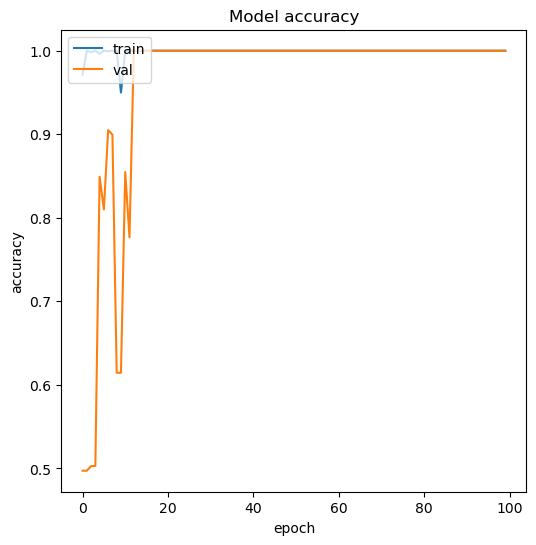

In [40]:
plot_and_save_graph(history)

In [41]:
cm_plot_labels = ['Normal', 'Hacked']

In [42]:
output_folder = 'Classification_report'
type = 'txt'

# Define the function to plot and save classification report
def plot_and_save_report(y_true, y_pred):
    base_name = 'report_' + nome

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    report = classification_report(y_true, y_pred, target_names=cm_plot_labels)
    print(report)

    with open(output_path, 'w') as f:
        f.write(report)

In [43]:
plot_and_save_report(y_true, y_pred)

              precision    recall  f1-score   support

      Normal       1.00      1.00      1.00        89
      Hacked       1.00      1.00      1.00        90

    accuracy                           1.00       179
   macro avg       1.00      1.00      1.00       179
weighted avg       1.00      1.00      1.00       179



In [44]:
output_folder = 'Confusion_matrix'
type = 'png'

# Define the flot confusion matrix
def plot_and_matrix(y_true, y_pred, cm_plot_labels):
    base_name = 'matrix_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    cm = confusion_matrix(y_true=y_true, y_pred=y_pred)

    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.xticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    plt.yticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    
    plt.savefig(output_path)

    plt.show()

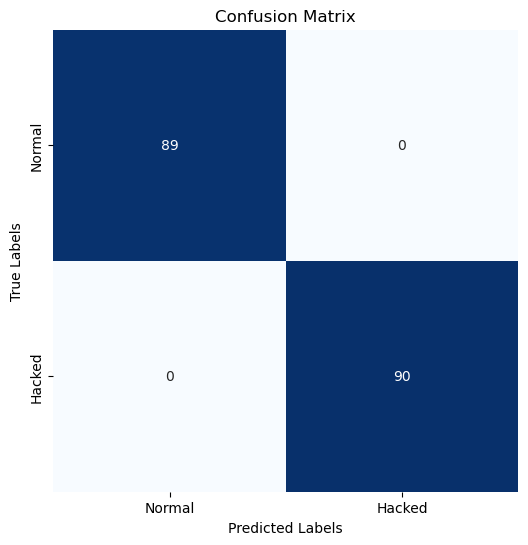

In [45]:
plot_and_matrix(y_true, y_pred, cm_plot_labels)

In [46]:
def plot_preds(X_test, y_true, y_pred):
    total_images = len(X_test)
    images_per_figure = 100
    cols = 5
    rows = (images_per_figure + cols - 1) // cols
    font_style = {'fontsize': 12, 'fontweight': 'bold'}

    for start in range(0, total_images, images_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + images_per_figure, total_images)

        for i in range(start, end):
            actual = 'Normal' if y_true[i] == 0 else 'Hacked'

            plt.subplot(rows, cols, i - start + 1)
            plt.title(f"Predict: {y_pred[i]} - {predictions[i][y_pred[i]] * 100:.2f}%\nActual: {y_true[i]} ({actual})", fontdict=font_style, color=('green' if y_pred[i] == y_true[i] else 'red'))
            plt.imshow(X_test[i], cmap='gray')
            plt.axis('off')

        plt.tight_layout()
        plt.show()

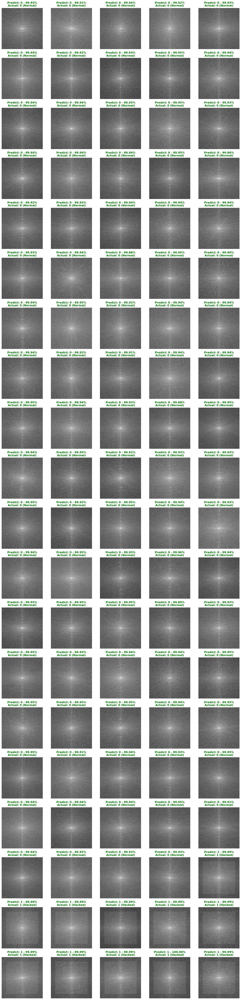

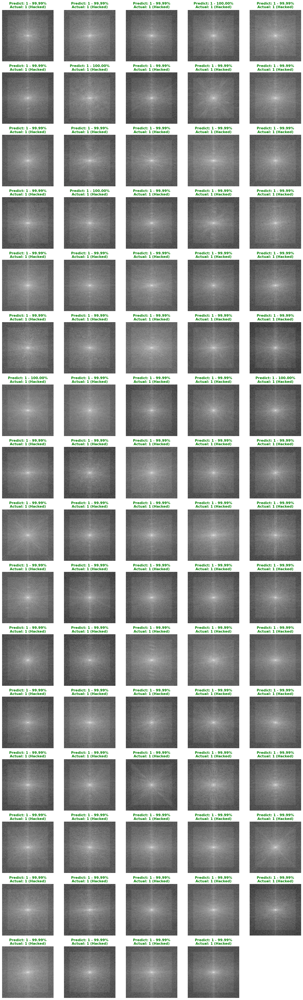

In [47]:
plot_preds(all_test_specs, y_true, y_pred)

In [48]:
# GC collect
gc.collect()

430160